In [ ]:
import os
import pandas as pd
import librosa

# Path utama adalah lokasi kerja saat ini
main_folder = os.getcwd()  # Menggunakan path tempat kerja saat ini

# List untuk menyimpan data
data = []

# Iterasi setiap folder di dalam folder utama
for label in os.listdir(main_folder):
    folder_path = os.path.join(main_folder, label)
    
    # Cek apakah folder_path adalah direktori
    if os.path.isdir(folder_path):
        # Iterasi semua file dalam folder
        for file in os.listdir(folder_path):
            # Pastikan hanya file .wav yang diambil
            if file.endswith(".wav"):
                # Path lengkap file
                file_path = os.path.join(folder_path, file)
                
                # Baca file audio
                try:
                    audio, sr = librosa.load(file_path, sr=None)  # sr=None untuk mempertahankan sample rate asli
                    data.append({
                        "File": file_path,
                        "Label": label,
                        "Audio": audio,  # Sinyal audio dalam bentuk array
                        "Sample Rate": sr  # Sample rate dari file
                    })
                except Exception as e:
                    print(f"Gagal membaca file {file_path}: {e}")

# Buat DataFrame dari data
df = pd.DataFrame(data)

# Simpan ke CSV (tanpa kolom Audio karena itu data besar)
df.drop(columns=["Audio"], inplace=True)
df.to_csv("audio_data_segmentasi.csv", index=False)

# Tampilkan DataFrame
print(df)


                                                 File          Label  \
0   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...   bonangbarung   
1   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...   bonangbarung   
2   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...   bonangbarung   
3   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...   bonangbarung   
4   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...   bonangbarung   
5   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...  bonangpenerus   
6   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...  bonangpenerus   
7   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...  bonangpenerus   
8   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...  bonangpenerus   
9   d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...  bonangpenerus   
10  d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...         demung   
11  d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...         demung   
12  d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus s...         de

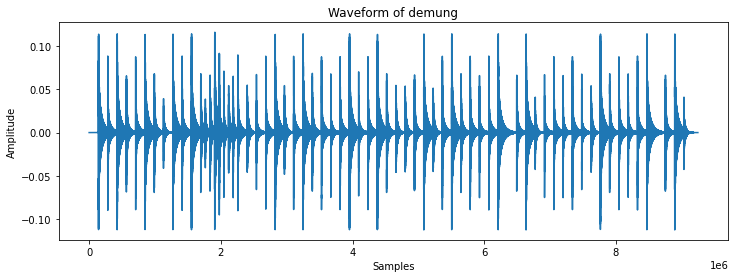

Sample Label: demung
Sample Rate: 44100 Hz


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd

# Fungsi untuk memilih sampel acak dari DataFrame dan memvisualisasikan
def visualize_random_sample(df):
    # Pilih baris secara acak dari DataFrame
    random_index = np.random.randint(0, len(df))
    random_row = df.iloc[random_index]
    
    # Ambil informasi file
    file_path = random_row['File']
    label = random_row['Label']
    
    # Baca file audio
    audio, sr = librosa.load(file_path, sr=None)
    
    # Visualisasi waveform
    plt.figure(figsize=(12, 4))
    plt.plot(audio)
    plt.title(f"Waveform of {label}")
    plt.xlabel("Samples")
    plt.ylabel("Amplitude")
    plt.show()
    
    # Mainkan audio
    return ipd.Audio(audio, rate=sr), label, audio, sr

# Pilih sampel acak dan visualisasikan
sample_audio, sample_label, sample_sound, sample_rate = visualize_random_sample(df)

print(f"Sample Label: {sample_label}")
print(f"Sample Rate: {sample_rate} Hz")

# Play the audio
sample_audio


In [9]:
import os
import librosa
import numpy as np
import soundfile as sf  # Untuk menyimpan file audio

# Fungsi untuk memotong audio menjadi segmen-segmen
def segment_audio(audio, sr, segment_duration=2):
    """
    Memotong audio menjadi segmen-segmen dengan durasi tertentu.
    
    Args:
        audio (numpy.ndarray): Sinyal audio.
        sr (int): Sampling rate audio.
        segment_duration (float): Durasi segmen dalam detik (default: 2 detik).
    
    Returns:
        list: Daftar segmen audio.
    """
    segment_samples = int(segment_duration * sr)  # Hitung jumlah sampel per segmen
    total_samples = len(audio)  # Total sampel dalam audio
    segments = []
    
    # Iterasi dan potong audio menjadi segmen
    for start in range(0, total_samples, segment_samples):
        end = start + segment_samples
        segment = audio[start:end]
        if len(segment) == segment_samples:  # Hanya ambil segmen dengan panjang penuh
            segments.append(segment)
    
    return segments

# Fungsi untuk memproses semua file dalam DataFrame
def process_all_files(df, segment_duration=2, output_dir="segments"):
    """
    Proses semua file audio dalam DataFrame dan menyimpan segmen.
    
    Args:
        df (pandas.DataFrame): DataFrame dengan kolom 'File' dan 'Label'.
        segment_duration (float): Durasi segmen dalam detik (default: 2 detik).
        output_dir (str): Direktori untuk menyimpan segmen audio.
    """
    os.makedirs(output_dir, exist_ok=True)  # Buat folder output jika belum ada
    
    for index, row in df.iterrows():
        file_path = row['File']
        
        # Ambil nama folder sebagai label
        label = os.path.basename(os.path.dirname(file_path))
        
        # Baca file audio
        try:
            audio, sr = librosa.load(file_path, sr=None)
            segments = segment_audio(audio, sr, segment_duration)
            
            # Buat folder khusus untuk label jika belum ada
            label_dir = os.path.join(output_dir, label)
            os.makedirs(label_dir, exist_ok=True)
            
            # Simpan setiap segmen ke file
            for i, segment in enumerate(segments):
                segment_filename = f"{os.path.basename(file_path).split('.')[0]}_seg{i+1}.wav"
                segment_path = os.path.join(label_dir, segment_filename)
                sf.write(segment_path, segment, sr)  # Simpan segmen ke file
                
            print(f"Processed {file_path}: {len(segments)} segments saved in {label_dir}.")
        except Exception as e:
            print(f"Error processing {file_path}: {e}")

# Contoh penggunaan
process_all_files(df, segment_duration=2, output_dir="audio_segmentasi")


Processed d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\006.wav: 104 segments saved in audio_segmentasi\bonangbarung.
Processed d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\007.wav: 39 segments saved in audio_segmentasi\bonangbarung.
Processed d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\008.wav: 56 segments saved in audio_segmentasi\bonangbarung.
Processed d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\009.wav: 59 segments saved in audio_segmentasi\bonangbarung.
Processed d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\010.wav: 93 segments saved in audio_segmentasi\bonangbarung.
Processed d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangpenerus\006.wav: 104 segments saved in audio_segmentasi\bonangpenerus.
Processed d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangpenerus\007.wav: 39 segments saved in audio_segmentasi\bonangpenerus.
Processed d:\K

In [7]:
for file_path in df['File']:
    print(file_path, os.path.exists(file_path))


d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\006.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\007.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\008.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\009.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangbarung\010.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangpenerus\006.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangpenerus\007.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangpenerus\008.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangpenerus\009.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\bonangpenerus\010.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\demung\001.wav True
d:\KULIAH\SEM 5\Datmin II\PROYEK AKHIR\harus segmentasi\demung\002.wav True
d:\KULIAH\SEM 5\Datmin 